In [1]:
import yaml
import subprocess
import glob
import numpy as np
import os

import matplotlib.pyplot as plt

In [2]:
# Function to replace the placeholder with the relaxation parameter in the template YAML file
def create_yaml_from_template(template_path, output_path, placeholder, new_value):
    with open(template_path, 'r') as file:
        content = file.read()

    # Replace the placeholder with the new relaxation parameter value
    updated_content = content.replace(placeholder, str(new_value))

    # Write the updated content to the output file
    with open(output_path, 'w') as file:
        file.write(updated_content)

# Function to run the Julia command
def run_julia_command():
    command = ["julia", "--project=@.", "/Users/bphung/Work/software/Norma.jl/src/Norma.jl", "cubes.yaml"]
    subprocess.run(command, check=True)

# Function to read the latest convergence values CSV file into a NumPy array
def read_latest_convergence_values():
    # Get the latest file matching the pattern
    list_of_files = glob.glob("convergence_values-*.csv")
    latest_file = max(list_of_files, key=os.path.getctime)

    # Read the CSV file into a NumPy array
    data = np.loadtxt(latest_file, delimiter=',', skiprows=0)  # Adjust skiprows if there's a header
    return data

def calculate_convergence_rate(errors):
    """Calculate the convergence rate for the last half of the error values."""
    n = len(errors)
    if n < 2:
        print(errors)
        raise ValueError("Not enough data points to calculate convergence rate.")
    
    # Extract the last half of the errors
    last_half_errors = errors[n // 2:]

    # Calculate log of the errors
    log_errors = np.log(last_half_errors)

    # Create an array of iteration indices for the last half
    iterations = np.arange(len(log_errors))

    # Fit a linear polynomial (degree 1) to the log errors
    slope, intercept = np.polyfit(iterations, log_errors, 1)
    return slope

In [3]:
number_of_iterations = []
rate_of_convergence_a = []
rate_of_convergence_r = []
relaxation_parameters = np.linspace(0,1.0,21)
for relaxation in relaxation_parameters:
    template_file_path = "cubes-template.yaml"
    output_file_path = "cubes.yaml"
    placeholder = "{replace_yaml}"  # Placeholder to be replaced
    new_relaxation_value = relaxation  # Change this to the desired relaxation parameter value

    # Create cubes.yaml from the template
    create_yaml_from_template(template_file_path, output_file_path, placeholder, new_relaxation_value)

    # Run the Julia command
    run_julia_command()

    # Read the latest convergence values into a NumPy array
    convergence_data = read_latest_convergence_values()
    convergence_data = convergence_data[np.nonzero(convergence_data)]
    convergence_absolute = convergence_data[0::2]
    convergence_relative = convergence_data[1::2]
    number_of_iterations.append(len(convergence_data) // 2 )
    try:
        convergence_rate_a = calculate_convergence_rate(convergence_absolute)
        convergence_rate_r = calculate_convergence_rate(convergence_relative)
    except:
       convergence_rate_a = -np.log(convergence_absolute[-1])
       convergence_rate_r = -np.log(convergence_relative[-1])
    rate_of_convergence_a.append(convergence_rate_a)
    rate_of_convergence_r.append(convergence_rate_r)


[ Info: Debugging disabled


Reading simulation file: cubes.yaml
Reading subsimulation file: cube-1.yaml
Reading subsimulation file: cube-2.yaml
Requested time step is 1.0e-6
Adjusted time step is 1.0e-6 with 101 stops
Initializing run at stop 0 with time = -1.00e-04
Computing initial acceleration
Computing initial acceleration
contact false
Advancing from stop 0 with time = -1.00e-04 to stop 1 with time = -9.90e-05
subcycle cube-1.yaml
|R|=9.368739720109489e-24
subcycle cube-2.yaml
|R|=4.0051681461495924e-24
contact false
Advancing from stop 1 with time = -9.90e-05 to stop 2 with time = -9.80e-05
subcycle cube-1.yaml
|R|=8.630756193420684e-24
subcycle cube-2.yaml
|R|=3.1936296174903908e-24
contact true
Contact initiation detected, redoing control step
Schwarz iteration=1
subcycle cube-1.yaml
|R|=3.3552473767083596e-24
subcycle cube-2.yaml
|R|=3.131086226314787e-24
Schwarz criterion |ΔX|=0.000734846041020297 |ΔX|/|X|=0.5477222945990223
Schwarz iteration=2
subcycle cube-1.yaml
|R|=3.3552473767083596e-24
subcycle cu

[ Info: Debugging disabled


Reading simulation file: cubes.yaml
Reading subsimulation file: cube-1.yaml
Reading subsimulation file: cube-2.yaml
Requested time step is 1.0e-6
Adjusted time step is 1.0e-6 with 101 stops
Initializing run at stop 0 with time = -1.00e-04
Computing initial acceleration
Computing initial acceleration
contact false
Advancing from stop 0 with time = -1.00e-04 to stop 1 with time = -9.90e-05
subcycle cube-1.yaml
|R|=9.368739720109489e-24
subcycle cube-2.yaml
|R|=4.0051681461495924e-24
contact false
Advancing from stop 1 with time = -9.90e-05 to stop 2 with time = -9.80e-05
subcycle cube-1.yaml
|R|=8.630756193420684e-24
subcycle cube-2.yaml
|R|=3.1936296174903908e-24
contact true
Contact initiation detected, redoing control step
Schwarz iteration=1
subcycle cube-1.yaml
|R|=3.355745210053341e-24
subcycle cube-2.yaml
|R|=3.131086226314787e-24
Schwarz criterion |ΔX|=0.0007410962852445046 |ΔX|/|X|=0.5523464343172373
Schwarz iteration=2
subcycle cube-1.yaml
|R|=1.2862197421537486e-12
subcycle cu

[ Info: Debugging disabled


Reading simulation file: cubes.yaml
Reading subsimulation file: cube-1.yaml
Reading subsimulation file: cube-2.yaml
Requested time step is 1.0e-6
Adjusted time step is 1.0e-6 with 101 stops
Initializing run at stop 0 with time = -1.00e-04
Computing initial acceleration
Computing initial acceleration
contact false
Advancing from stop 0 with time = -1.00e-04 to stop 1 with time = -9.90e-05
subcycle cube-1.yaml
|R|=9.368739720109489e-24
subcycle cube-2.yaml
|R|=4.0051681461495924e-24
contact false
Advancing from stop 1 with time = -9.90e-05 to stop 2 with time = -9.80e-05
subcycle cube-1.yaml
|R|=8.630756193420684e-24
subcycle cube-2.yaml
|R|=3.1936296174903908e-24
contact true
Contact initiation detected, redoing control step
Schwarz iteration=1
subcycle cube-1.yaml
|R|=3.382223079454487e-24
subcycle cube-2.yaml
|R|=3.131086226314787e-24
Schwarz criterion |ΔX|=0.0007475952808861249 |ΔX|/|X|=0.5570857695364895
Schwarz iteration=2
subcycle cube-1.yaml
|R|=3.858659226461245e-12
subcycle cub

[ Info: Debugging disabled


Reading simulation file: cubes.yaml
Reading subsimulation file: cube-1.yaml
Reading subsimulation file: cube-2.yaml
Requested time step is 1.0e-6
Adjusted time step is 1.0e-6 with 101 stops
Initializing run at stop 0 with time = -1.00e-04
Computing initial acceleration
Computing initial acceleration
contact false
Advancing from stop 0 with time = -1.00e-04 to stop 1 with time = -9.90e-05
subcycle cube-1.yaml
|R|=9.368739720109489e-24
subcycle cube-2.yaml
|R|=4.0051681461495924e-24
contact false
Advancing from stop 1 with time = -9.90e-05 to stop 2 with time = -9.80e-05
subcycle cube-1.yaml
|R|=8.630756193420684e-24
subcycle cube-2.yaml
|R|=3.1936296174903908e-24
contact true
Contact initiation detected, redoing control step
Schwarz iteration=1
subcycle cube-1.yaml
|R|=3.457253792178454e-24
subcycle cube-2.yaml
|R|=3.131086226314787e-24
Schwarz criterion |ΔX|=0.0007543365986104637 |ΔX|/|X|=0.5619337096388627
Schwarz iteration=2
subcycle cube-1.yaml
|R|=1.5752910326854155e-12
subcycle cu

[ Info: Debugging disabled


Reading simulation file: cubes.yaml
Reading subsimulation file: cube-1.yaml
Reading subsimulation file: cube-2.yaml
Requested time step is 1.0e-6
Adjusted time step is 1.0e-6 with 101 stops
Initializing run at stop 0 with time = -1.00e-04
Computing initial acceleration
Computing initial acceleration
contact false
Advancing from stop 0 with time = -1.00e-04 to stop 1 with time = -9.90e-05
subcycle cube-1.yaml
|R|=9.368739720109489e-24
subcycle cube-2.yaml
|R|=4.0051681461495924e-24
contact false
Advancing from stop 1 with time = -9.90e-05 to stop 2 with time = -9.80e-05
subcycle cube-1.yaml
|R|=8.630756193420684e-24
subcycle cube-2.yaml
|R|=3.1936296174903908e-24
contact true
Contact initiation detected, redoing control step
Schwarz iteration=1
subcycle cube-1.yaml
|R|=3.356939708860768e-24
subcycle cube-2.yaml
|R|=3.131086226314787e-24
Schwarz criterion |ΔX|=0.0007613138012693608 |ΔX|/|X|=0.5668836112447768
Schwarz iteration=2
subcycle cube-1.yaml
|R|=2.8760747774580336e-12
subcycle cu

[ Info: Debugging disabled


Reading simulation file: cubes.yaml
Reading subsimulation file: cube-1.yaml
Reading subsimulation file: cube-2.yaml
Requested time step is 1.0e-6
Adjusted time step is 1.0e-6 with 101 stops
Initializing run at stop 0 with time = -1.00e-04
Computing initial acceleration
Computing initial acceleration
contact false
Advancing from stop 0 with time = -1.00e-04 to stop 1 with time = -9.90e-05
subcycle cube-1.yaml
|R|=9.368739720109489e-24
subcycle cube-2.yaml
|R|=4.0051681461495924e-24
contact false
Advancing from stop 1 with time = -9.90e-05 to stop 2 with time = -9.80e-05
subcycle cube-1.yaml
|R|=8.630756193420684e-24
subcycle cube-2.yaml
|R|=3.1936296174903908e-24
contact true
Contact initiation detected, redoing control step
Schwarz iteration=1
subcycle cube-1.yaml
|R|=3.356840183528059e-24
subcycle cube-2.yaml
|R|=3.131086226314787e-24
Schwarz criterion |ΔX|=0.0007685204642709285 |ΔX|/|X|=0.5719288028616779
Schwarz iteration=2
subcycle cube-1.yaml
|R|=3.150582065370831e-12
subcycle cub

[ Info: Debugging disabled


Reading simulation file: cubes.yaml
Reading subsimulation file: cube-1.yaml
Reading subsimulation file: cube-2.yaml
Requested time step is 1.0e-6
Adjusted time step is 1.0e-6 with 101 stops
Initializing run at stop 0 with time = -1.00e-04
Computing initial acceleration
Computing initial acceleration
contact false
Advancing from stop 0 with time = -1.00e-04 to stop 1 with time = -9.90e-05
subcycle cube-1.yaml
|R|=9.368739720109489e-24
subcycle cube-2.yaml
|R|=4.0051681461495924e-24
contact false
Advancing from stop 1 with time = -9.90e-05 to stop 2 with time = -9.80e-05
subcycle cube-1.yaml
|R|=8.630756193420684e-24
subcycle cube-2.yaml
|R|=3.1936296174903908e-24
contact true
Contact initiation detected, redoing control step
Schwarz iteration=1
subcycle cube-1.yaml
|R|=3.4807531413255846e-24
subcycle cube-2.yaml
|R|=3.131086226314787e-24
Schwarz criterion |ΔX|=0.0007759501942800219 |ΔX|/|X|=0.5770626082848515
Schwarz iteration=2
subcycle cube-1.yaml
|R|=9.094947017729282e-13
subcycle cu

[ Info: Debugging disabled


Reading simulation file: cubes.yaml
Reading subsimulation file: cube-1.yaml
Reading subsimulation file: cube-2.yaml
Requested time step is 1.0e-6
Adjusted time step is 1.0e-6 with 101 stops
Initializing run at stop 0 with time = -1.00e-04
Computing initial acceleration
Computing initial acceleration
contact false
Advancing from stop 0 with time = -1.00e-04 to stop 1 with time = -9.90e-05
subcycle cube-1.yaml
|R|=9.368739720109489e-24
subcycle cube-2.yaml
|R|=4.0051681461495924e-24
contact false
Advancing from stop 1 with time = -9.90e-05 to stop 2 with time = -9.80e-05
subcycle cube-1.yaml
|R|=8.630756193420684e-24
subcycle cube-2.yaml
|R|=3.1936296174903908e-24
contact true
Contact initiation detected, redoing control step
Schwarz iteration=1
subcycle cube-1.yaml
|R|=3.38113632618412e-24
subcycle cube-2.yaml
|R|=3.131086226314787e-24
Schwarz criterion |ΔX|=0.000783596646242953 |ΔX|/|X|=0.5822783686745862
Schwarz iteration=2
subcycle cube-1.yaml
|R|=3.5224578334304324e-12
subcycle cube

[ Info: Debugging disabled


Reading simulation file: cubes.yaml
Reading subsimulation file: cube-1.yaml
Reading subsimulation file: cube-2.yaml
Requested time step is 1.0e-6
Adjusted time step is 1.0e-6 with 101 stops
Initializing run at stop 0 with time = -1.00e-04
Computing initial acceleration
Computing initial acceleration
contact false
Advancing from stop 0 with time = -1.00e-04 to stop 1 with time = -9.90e-05
subcycle cube-1.yaml
|R|=9.368739720109489e-24
subcycle cube-2.yaml
|R|=4.0051681461495924e-24
contact false
Advancing from stop 1 with time = -9.90e-05 to stop 2 with time = -9.80e-05
subcycle cube-1.yaml
|R|=8.630756193420684e-24
subcycle cube-2.yaml
|R|=3.1936296174903908e-24
contact true
Contact initiation detected, redoing control step
Schwarz iteration=1
subcycle cube-1.yaml
|R|=3.380642231936741e-24
subcycle cube-2.yaml
|R|=3.131086226314787e-24
Schwarz criterion |ΔX|=0.0007914535387520886 |ΔX|/|X|=0.5875694632556098
Schwarz iteration=2
subcycle cube-1.yaml
|R|=2.8760747774580336e-12
subcycle cu

[ Info: Debugging disabled


Reading simulation file: cubes.yaml
Reading subsimulation file: cube-1.yaml
Reading subsimulation file: cube-2.yaml
Requested time step is 1.0e-6
Adjusted time step is 1.0e-6 with 101 stops
Initializing run at stop 0 with time = -1.00e-04
Computing initial acceleration
Computing initial acceleration
contact false
Advancing from stop 0 with time = -1.00e-04 to stop 1 with time = -9.90e-05
subcycle cube-1.yaml
|R|=9.368739720109489e-24
subcycle cube-2.yaml
|R|=4.0051681461495924e-24
contact false
Advancing from stop 1 with time = -9.90e-05 to stop 2 with time = -9.80e-05
subcycle cube-1.yaml
|R|=8.630756193420684e-24
subcycle cube-2.yaml
|R|=3.1936296174903908e-24
contact true
Contact initiation detected, redoing control step
Schwarz iteration=1
subcycle cube-1.yaml
|R|=3.4803691853218436e-24
subcycle cube-2.yaml
|R|=3.131086226314787e-24
Schwarz criterion |ΔX|=0.0007995146677849031 |ΔX|/|X|=0.5929293286043695
Schwarz iteration=2
subcycle cube-1.yaml
|R|=2.5724394843074972e-12
subcycle c

[ Info: Debugging disabled


Reading simulation file: cubes.yaml
Reading subsimulation file: cube-1.yaml
Reading subsimulation file: cube-2.yaml
Requested time step is 1.0e-6
Adjusted time step is 1.0e-6 with 101 stops
Initializing run at stop 0 with time = -1.00e-04
Computing initial acceleration
Computing initial acceleration
contact false
Advancing from stop 0 with time = -1.00e-04 to stop 1 with time = -9.90e-05
subcycle cube-1.yaml
|R|=9.368739720109489e-24
subcycle cube-2.yaml
|R|=4.0051681461495924e-24
contact false
Advancing from stop 1 with time = -9.90e-05 to stop 2 with time = -9.80e-05
subcycle cube-1.yaml
|R|=8.630756193420684e-24
subcycle cube-2.yaml
|R|=3.1936296174903908e-24
contact true
Contact initiation detected, redoing control step
Schwarz iteration=1
subcycle cube-1.yaml
|R|=3.4803691853218436e-24
subcycle cube-2.yaml
|R|=3.131086226314787e-24
Schwarz criterion |ΔX|=0.0008077739188678995 |ΔX|/|X|=0.5983514765072547
Schwarz iteration=2
subcycle cube-1.yaml
|R|=2.406296799622024e-12
subcycle cu

[ Info: Debugging disabled


Reading simulation file: cubes.yaml
Reading subsimulation file: cube-1.yaml
Reading subsimulation file: cube-2.yaml
Requested time step is 1.0e-6
Adjusted time step is 1.0e-6 with 101 stops
Initializing run at stop 0 with time = -1.00e-04
Computing initial acceleration
Computing initial acceleration
contact false
Advancing from stop 0 with time = -1.00e-04 to stop 1 with time = -9.90e-05
subcycle cube-1.yaml
|R|=9.368739720109489e-24
subcycle cube-2.yaml
|R|=4.0051681461495924e-24
contact false
Advancing from stop 1 with time = -9.90e-05 to stop 2 with time = -9.80e-05
subcycle cube-1.yaml
|R|=8.630756193420684e-24
subcycle cube-2.yaml
|R|=3.1936296174903908e-24
contact true
Contact initiation detected, redoing control step
Schwarz iteration=1
subcycle cube-1.yaml
|R|=3.457253792178454e-24
subcycle cube-2.yaml
|R|=3.131086226314787e-24
Schwarz criterion |ΔX|=0.000816225277728645 |ΔX|/|X|=0.60382951038823
Schwarz iteration=2
subcycle cube-1.yaml
|R|=2.227797943108433e-12
subcycle cube-2

[ Info: Debugging disabled


Reading simulation file: cubes.yaml
Reading subsimulation file: cube-1.yaml
Reading subsimulation file: cube-2.yaml
Requested time step is 1.0e-6
Adjusted time step is 1.0e-6 with 101 stops
Initializing run at stop 0 with time = -1.00e-04
Computing initial acceleration
Computing initial acceleration
contact false
Advancing from stop 0 with time = -1.00e-04 to stop 1 with time = -9.90e-05
subcycle cube-1.yaml
|R|=9.368739720109489e-24
subcycle cube-2.yaml
|R|=4.0051681461495924e-24
contact false
Advancing from stop 1 with time = -9.90e-05 to stop 2 with time = -9.80e-05
subcycle cube-1.yaml
|R|=8.630756193420684e-24
subcycle cube-2.yaml
|R|=3.1936296174903908e-24
contact true
Contact initiation detected, redoing control step
Schwarz iteration=1
subcycle cube-1.yaml
|R|=3.381037513111075e-24
subcycle cube-2.yaml
|R|=3.131086226314787e-24
Schwarz criterion |ΔX|=0.0008248628395092142 |ΔX|/|X|=0.6093571403176564
Schwarz iteration=2
subcycle cube-1.yaml
|R|=3.016452674596985e-12
subcycle cub

[ Info: Debugging disabled


Reading simulation file: cubes.yaml
Reading subsimulation file: cube-1.yaml
Reading subsimulation file: cube-2.yaml
Requested time step is 1.0e-6
Adjusted time step is 1.0e-6 with 101 stops
Initializing run at stop 0 with time = -1.00e-04
Computing initial acceleration
Computing initial acceleration
contact false
Advancing from stop 0 with time = -1.00e-04 to stop 1 with time = -9.90e-05
subcycle cube-1.yaml
|R|=9.368739720109489e-24
subcycle cube-2.yaml
|R|=4.0051681461495924e-24
contact false
Advancing from stop 1 with time = -9.90e-05 to stop 2 with time = -9.80e-05
subcycle cube-1.yaml
|R|=8.630756193420684e-24
subcycle cube-2.yaml
|R|=3.1936296174903908e-24
contact true
Contact initiation detected, redoing control step
Schwarz iteration=1
subcycle cube-1.yaml
|R|=3.3552473767083596e-24
subcycle cube-2.yaml
|R|=3.131086226314787e-24
Schwarz criterion |ΔX|=0.0008336808166218073 |ΔX|/|X|=0.6149281966253786
Schwarz iteration=2
subcycle cube-1.yaml
|R|=5.4569682106375694e-12
subcycle c

[ Info: Debugging disabled


Reading simulation file: cubes.yaml
Reading subsimulation file: cube-1.yaml
Reading subsimulation file: cube-2.yaml
Requested time step is 1.0e-6
Adjusted time step is 1.0e-6 with 101 stops
Initializing run at stop 0 with time = -1.00e-04
Computing initial acceleration
Computing initial acceleration
contact false
Advancing from stop 0 with time = -1.00e-04 to stop 1 with time = -9.90e-05
subcycle cube-1.yaml
|R|=9.368739720109489e-24
subcycle cube-2.yaml
|R|=4.0051681461495924e-24
contact false
Advancing from stop 1 with time = -9.90e-05 to stop 2 with time = -9.80e-05
subcycle cube-1.yaml
|R|=8.630756193420684e-24
subcycle cube-2.yaml
|R|=3.1936296174903908e-24
contact true
Contact initiation detected, redoing control step
Schwarz iteration=1
subcycle cube-1.yaml
|R|=3.382223079454487e-24
subcycle cube-2.yaml
|R|=3.131086226314787e-24
Schwarz criterion |ΔX|=0.0008426735453324757 |ΔX|/|X|=0.6205366421506128
Schwarz iteration=2
subcycle cube-1.yaml
|R|=4.455595886216866e-12
subcycle cub

[ Info: Debugging disabled


Reading simulation file: cubes.yaml
Reading subsimulation file: cube-1.yaml
Reading subsimulation file: cube-2.yaml
Requested time step is 1.0e-6
Adjusted time step is 1.0e-6 with 101 stops
Initializing run at stop 0 with time = -1.00e-04
Computing initial acceleration
Computing initial acceleration
contact false
Advancing from stop 0 with time = -1.00e-04 to stop 1 with time = -9.90e-05
subcycle cube-1.yaml
|R|=9.368739720109489e-24
subcycle cube-2.yaml
|R|=4.0051681461495924e-24
contact false
Advancing from stop 1 with time = -9.90e-05 to stop 2 with time = -9.80e-05
subcycle cube-1.yaml
|R|=8.630756193420684e-24
subcycle cube-2.yaml
|R|=3.1936296174903908e-24
contact true
Contact initiation detected, redoing control step
Schwarz iteration=1
subcycle cube-1.yaml
|R|=3.382223079454487e-24
subcycle cube-2.yaml
|R|=3.131086226314787e-24
Schwarz criterion |ΔX|=0.000851835491161999 |ΔX|/|X|=0.6261765831689095
Schwarz iteration=2
subcycle cube-1.yaml
|R|=5.4569682106375694e-12
subcycle cub

[ Info: Debugging disabled


Reading simulation file: cubes.yaml
Reading subsimulation file: cube-1.yaml
Reading subsimulation file: cube-2.yaml
Requested time step is 1.0e-6
Adjusted time step is 1.0e-6 with 101 stops
Initializing run at stop 0 with time = -1.00e-04
Computing initial acceleration
Computing initial acceleration
contact false
Advancing from stop 0 with time = -1.00e-04 to stop 1 with time = -9.90e-05
subcycle cube-1.yaml
|R|=9.368739720109489e-24
subcycle cube-2.yaml
|R|=4.0051681461495924e-24
contact false
Advancing from stop 1 with time = -9.90e-05 to stop 2 with time = -9.80e-05
subcycle cube-1.yaml
|R|=8.630756193420684e-24
subcycle cube-2.yaml
|R|=3.1936296174903908e-24
contact true
Contact initiation detected, redoing control step
Schwarz iteration=1
subcycle cube-1.yaml
|R|=3.380642231936741e-24
subcycle cube-2.yaml
|R|=3.131086226314787e-24
Schwarz criterion |ΔX|=0.0008611612531943155 |ΔX|/|X|=0.6318422790426611
Schwarz iteration=2
subcycle cube-1.yaml
|R|=2.5724394843074972e-12
subcycle cu

[ Info: Debugging disabled


Reading simulation file: cubes.yaml
Reading subsimulation file: cube-1.yaml
Reading subsimulation file: cube-2.yaml
Requested time step is 1.0e-6
Adjusted time step is 1.0e-6 with 101 stops
Initializing run at stop 0 with time = -1.00e-04
Computing initial acceleration
Computing initial acceleration
contact false
Advancing from stop 0 with time = -1.00e-04 to stop 1 with time = -9.90e-05
subcycle cube-1.yaml
|R|=9.368739720109489e-24
subcycle cube-2.yaml
|R|=4.0051681461495924e-24
contact false
Advancing from stop 1 with time = -9.90e-05 to stop 2 with time = -9.80e-05
subcycle cube-1.yaml
|R|=8.630756193420684e-24
subcycle cube-2.yaml
|R|=3.1936296174903908e-24
contact true
Contact initiation detected, redoing control step
Schwarz iteration=1
subcycle cube-1.yaml
|R|=3.4560939642032336e-24
subcycle cube-2.yaml
|R|=3.131086226314787e-24
Schwarz criterion |ΔX|=0.0008706455673827345 |ΔX|/|X|=0.6375281506464371
Schwarz iteration=2
subcycle cube-1.yaml
|R|=6.03290534919397e-12
subcycle cub

[ Info: Debugging disabled


Reading simulation file: cubes.yaml
Reading subsimulation file: cube-1.yaml
Reading subsimulation file: cube-2.yaml
Requested time step is 1.0e-6
Adjusted time step is 1.0e-6 with 101 stops
Initializing run at stop 0 with time = -1.00e-04
Computing initial acceleration
Computing initial acceleration
contact false
Advancing from stop 0 with time = -1.00e-04 to stop 1 with time = -9.90e-05
subcycle cube-1.yaml
|R|=9.368739720109489e-24
subcycle cube-2.yaml
|R|=4.0051681461495924e-24
contact false
Advancing from stop 1 with time = -9.90e-05 to stop 2 with time = -9.80e-05
subcycle cube-1.yaml
|R|=8.630756193420684e-24
subcycle cube-2.yaml
|R|=3.1936296174903908e-24
contact true
Contact initiation detected, redoing control step
Schwarz iteration=1
subcycle cube-1.yaml
|R|=3.4807531413255846e-24
subcycle cube-2.yaml
|R|=3.131086226314787e-24
Schwarz criterion |ΔX|=0.0008802833089427537 |ΔX|/|X|=0.6432287876220234
Schwarz iteration=2
subcycle cube-1.yaml
|R|=3.637978807091713e-12
subcycle cu

[ Info: Debugging disabled


Reading simulation file: cubes.yaml
Reading subsimulation file: cube-1.yaml
Reading subsimulation file: cube-2.yaml
Requested time step is 1.0e-6
Adjusted time step is 1.0e-6 with 101 stops
Initializing run at stop 0 with time = -1.00e-04
Computing initial acceleration
Computing initial acceleration
contact false
Advancing from stop 0 with time = -1.00e-04 to stop 1 with time = -9.90e-05
subcycle cube-1.yaml
|R|=9.368739720109489e-24
subcycle cube-2.yaml
|R|=4.0051681461495924e-24
contact false
Advancing from stop 1 with time = -9.90e-05 to stop 2 with time = -9.80e-05
subcycle cube-1.yaml
|R|=8.630756193420684e-24
subcycle cube-2.yaml
|R|=3.1936296174903908e-24
contact true
Contact initiation detected, redoing control step
Schwarz iteration=1
subcycle cube-1.yaml
|R|=3.356840183528059e-24
subcycle cube-2.yaml
|R|=3.131086226314787e-24
Schwarz criterion |ΔX|=0.0008900694939178647 |ΔX|/|X|=0.6489389545205902
Schwarz iteration=2
subcycle cube-1.yaml
|R|=2.5724394843074972e-12
subcycle cu

[ Info: Debugging disabled


Reading simulation file: cubes.yaml
Reading subsimulation file: cube-1.yaml
Reading subsimulation file: cube-2.yaml
Requested time step is 1.0e-6
Adjusted time step is 1.0e-6 with 101 stops
Initializing run at stop 0 with time = -1.00e-04
Computing initial acceleration
Computing initial acceleration
contact false
Advancing from stop 0 with time = -1.00e-04 to stop 1 with time = -9.90e-05
subcycle cube-1.yaml
|R|=9.368739720109489e-24
subcycle cube-2.yaml
|R|=4.0051681461495924e-24
contact false
Advancing from stop 1 with time = -9.90e-05 to stop 2 with time = -9.80e-05
subcycle cube-1.yaml
|R|=8.630756193420684e-24
subcycle cube-2.yaml
|R|=3.1936296174903908e-24
contact true
Contact initiation detected, redoing control step
Schwarz iteration=1
subcycle cube-1.yaml
|R|=3.356840183528059e-24
subcycle cube-2.yaml
|R|=3.131086226314787e-24
Schwarz criterion |ΔX|=0.0008999992800014918 |ΔX|/|X|=0.6546535958910341
Schwarz iteration=2
subcycle cube-1.yaml
|R|=5.752149554916067e-12
subcycle cub

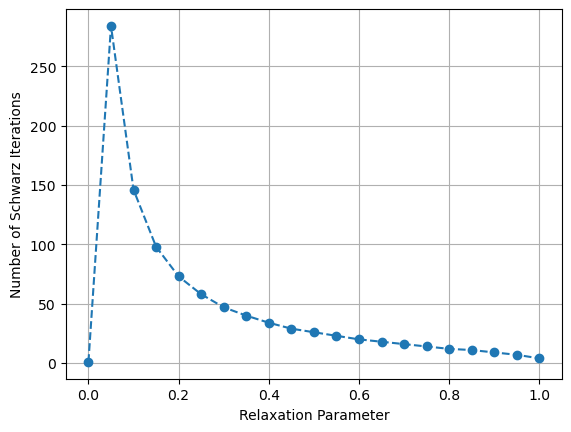

In [4]:

# number_of_iterations = []
# rate_of_convergence_a = []
# rate_of_convergence_r = []
# relaxation_parameters = np.linspace(0,1.0,11)
plt.plot(relaxation_parameters, np.array(number_of_iterations), 'o--')
plt.xlabel('Relaxation Parameter')
plt.ylabel('Number of Schwarz Iterations')
#plt.yticks(np.arange(0, np.max(number_of_iterations), step=20))
plt.grid()
plt.savefig('Schwarz_Iterations.png')


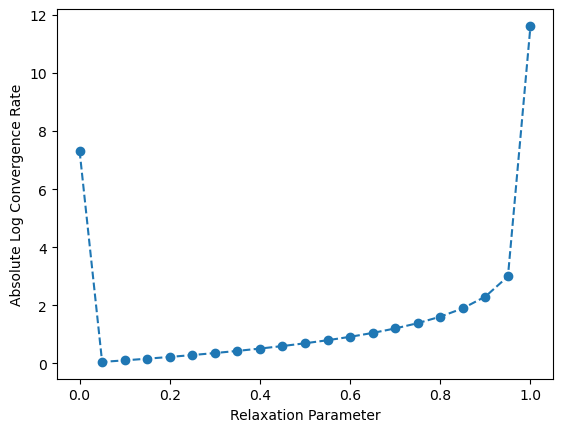

In [5]:
plt.plot(relaxation_parameters, np.abs(rate_of_convergence_a), 'o--')
plt.xlabel('Relaxation Parameter')
plt.ylabel('Absolute Log Convergence Rate')
plt.savefig('absolute_convergence.png')

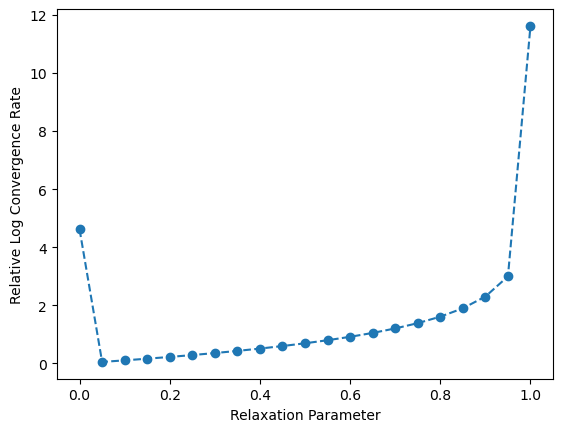

In [6]:
plt.plot(relaxation_parameters, np.abs(rate_of_convergence_r), 'o--')
plt.xlabel('Relaxation Parameter')
plt.ylabel('Relative Log Convergence Rate')
plt.savefig('relative_convergence.png')